In [1]:
import sqlite3
import pandas as pd
import geopandas
import matplotlib.pyplot as plt

In [2]:
db_path = 'sql/eleicao.db' 
connection = sqlite3.connect(db_path)

In [3]:
cur = connection.cursor()

In [4]:
querry = """
SELECT name FROM sqlite_master WHERE type = 'table';
"""

r = pd.read_sql_query(querry,connection)
r

,name
0,geometry_columns
1,spatial_ref_sys
2,municipio
3,sqlite_sequence
4,votos_partido
5,partido
6,federacao
7,coligacao
8,municipio_nome
9,votos_candidato


In [5]:
querry = """
SELECT * 
FROM municipio
"""

r = pd.read_sql_query(querry,connection)
r.head()

,ogc_fid,GEOMETRY,cd_mun,area_km2
0,1,b'\x01\x03\x00\x00\x00\x01\x00\x00\x00\x85\t\x...,2900108,538.677
1,2,b'\x01\x03\x00\x00\x00\x01\x00\x00\x00\xfd\x02...,2900207,1604.923
2,3,b'\x01\x03\x00\x00\x00\x01\x00\x00\x00M\x04\x0...,2900306,181.475
3,4,b'\x01\x03\x00\x00\x00\x01\x00\x00\x00A\x11\x0...,2900355,629.099
4,5,b'\x01\x03\x00\x00\x00\x01\x00\x00\x00`\x13\x0...,2900405,742.775


In [6]:
querry = """
SELECT * FROM votos_partido
"""

r = pd.read_sql_query(querry,connection)
r.head()

,CD_MUN,NR_TURNO,NR_ZONA,DS_CARGO,NR_PARTIDO,QT_VOTOS_LEGENDA_VALIDOS,QT_TOTAL_VOTOS_LEG_VALIDOS,QT_VOTOS_NOMINAIS_VALIDOS,SQ_COLIGACAO
0,2907806,1,82,Deputado Federal,40,2,2,46,50001681311
1,2923902,1,133,Deputado Federal,40,2,2,22,50001681311
2,2923209,1,94,Deputado Federal,40,7,7,581,50001681311
3,2921500,1,50,Deputado Federal,40,5,5,128,50001681311
4,2921203,1,103,Deputado Federal,40,1,1,49,50001681311


In [7]:
querry = """
SELECT * FROM votos_candidato
"""

r = pd.read_sql_query(querry,connection)
r.head()

,NR_TURNO,NR_ZONA,DS_CARGO,NR_CANDIDATO,NM_CANDIDATO,NM_URNA_CANDIDATO,NM_SOCIAL_CANDIDATO,CD_SITUACAO_CANDIDATURA,DS_SITUACAO_CANDIDATURA,NR_PARTIDO,SG_FEDERACAO,SQ_COLIGACAO,QT_VOTOS_NOMINAIS,NM_TIPO_DESTINACAO_VOTOS,QT_VOTOS_NOMINAIS_VALIDOS,CD_SIT_TOT_TURNO,DS_SIT_TOT_TURNO,CD_MUN
0,1,59,Deputado Estadual,22380,DIEGO CASTRO BARBOSA,DR. DIEGO CASTRO,None,12,APTO,22,None,50001681438,10,Válido,10,3,ELEITO POR MÉDIA,2903706
1,1,55,Deputado Estadual,22380,DIEGO CASTRO BARBOSA,DR. DIEGO CASTRO,None,12,APTO,22,None,50001681438,5,Válido,5,3,ELEITO POR MÉDIA,2922052
2,1,128,Deputado Estadual,22380,DIEGO CASTRO BARBOSA,DR. DIEGO CASTRO,None,12,APTO,22,None,50001681438,26,Válido,26,3,ELEITO POR MÉDIA,2929503
3,1,177,Deputado Estadual,22380,DIEGO CASTRO BARBOSA,DR. DIEGO CASTRO,None,12,APTO,22,None,50001681438,29,Válido,29,3,ELEITO POR MÉDIA,2903508
4,1,136,Deputado Estadual,22380,DIEGO CASTRO BARBOSA,DR. DIEGO CASTRO,None,12,APTO,22,None,50001681438,3,Válido,3,3,ELEITO POR MÉDIA,2903300


In [8]:
querry = """
SELECT * FROM federacao
"""

r = pd.read_sql_query(querry,connection)
r.head()

,SG_FEDERACAO,NM_FEDERACAO,DS_COMPOSICAO_FEDERACAO
0,PT/PC do B/PV,Federação Brasil da Esperança - FE BRASIL,PC do B / PT / PV
1,PSDB/CIDADANIA,Federação PSDB Cidadania,CIDADANIA / PSDB
2,PSOL/REDE,Federação PSOL REDE,PSOL / REDE


In [9]:
querry = """
SELECT * FROM coligacao
"""

r = pd.read_sql_query(querry,connection)
r.head()

,NM_COLIGACAO,SQ_COLIGACAO,DS_COMPOSICAO_COLIGACAO
0,PARTIDO ISOLADO,50001681311,PSB
1,PARTIDO ISOLADO,50001681167,DC
2,PARTIDO ISOLADO,50001681346,PSD
3,FEDERAÇÃO,50001681283,Federação Brasil da Esperança - FE BRASIL(PT/P...
4,FEDERAÇÃO,50001681679,Federação PSDB Cidadania(PSDB/CIDADANIA)


In [10]:
querry = """
SELECT * FROM municipio_nome
"""

r = pd.read_sql_query(querry,connection)
r.head()

,CD_MUN,NM_MUN
0,2907806,CÍCERO DANTAS
1,2923902,PAU BRASIL
2,2923209,OLIVEIRA DOS BREJINHOS
3,2921500,MONTE SANTO
4,2921203,MIGUEL CALMON


# Visualizar

In [12]:
querry = """
SELECT vc.*, SUM(QT_VOTOS_NOMINAIS_VALIDOS) as total_votos
From votos_candidato as vc
WHERE vc.DS_CARGO = 'Deputado Federal' AND vc.DS_SITUACAO_CANDIDATURA = 'APTO' AND vc.DS_SIT_TOT_TURNO != "NÃO ELEITO" AND vc.DS_SIT_TOT_TURNO != "SUPLENTE" 
Group by NM_URNA_CANDIDATO
ORDER BY total_votos
"""

r = pd.read_sql_query(querry,connection)
r

,NR_TURNO,NR_ZONA,DS_CARGO,NR_CANDIDATO,NM_CANDIDATO,NM_URNA_CANDIDATO,NM_SOCIAL_CANDIDATO,CD_SITUACAO_CANDIDATURA,DS_SITUACAO_CANDIDATURA,NR_PARTIDO,SG_FEDERACAO,SQ_COLIGACAO,QT_VOTOS_NOMINAIS,NM_TIPO_DESTINACAO_VOTOS,QT_VOTOS_NOMINAIS_VALIDOS,CD_SIT_TOT_TURNO,DS_SIT_TOT_TURNO,CD_MUN,total_votos
0,1,134,Deputado Federal,1919,RAIMUNDO MAGALHÃES COSTA,RAIMUNDO COSTA,None,12,APTO,19,None,50001681772,10,Válido,10,3,ELEITO POR MÉDIA,2932309,53486
1,1,58,Deputado Federal,1234,FELIX DE ALMEIDA MENDONCA JUNIOR,FELIX MENDONÇA,None,12,APTO,12,None,50001682236,19,Válido,19,3,ELEITO POR MÉDIA,2931004,71774
2,1,90,Deputado Federal,7000,MANOEL ISIDÓRIO DE SANTANA JÚNIOR,PASTOR SARGENTO ISIDÓRIO,None,12,APTO,70,None,50001681169,0,Válido,0,2,ELEITO POR QP,2920304,77164
3,1,97,Deputado Federal,4422,JOSÉ ALVES ROCHA,JOSÉ ROCHA,None,12,APTO,44,None,50001682586,3,Válido,3,3,ELEITO POR MÉDIA,2928406,78833
4,1,27,Deputado Federal,4411,LEUR ANTONIO DE BRITTO LOMANTO JUNIOR,LEUR LOMANTO JR,None,12,APTO,44,None,50001682586,2,Válido,2,2,ELEITO POR QP,2916203,82004
5,1,131,Deputado Federal,1000,ROGERIA DE ALMEIDA PEREIRA DOS SANTOS,ROGERIA SANTOS,None,12,APTO,10,None,50001682194,31,Válido,31,3,ELEITO POR MÉDIA,2911600,82012
6,1,98,Deputado Federal,1310,VALMIR CARLOS DA ASSUNÇÃO,VALMIR ASSUNÇÃO,None,12,APTO,13,PT/PC do B/PV,50001681283,9,Válido,9,3,ELEITO POR MÉDIA,2922250,90148
7,1,102,Deputado Federal,2288,JOÃO CARLOS PAOLILO BACELAR FILHO,JOÃO CARLOS BACELAR,None,12,APTO,22,None,50001681431,4094,Válido,4094,2,ELEITO POR QP,2925907,90229
8,1,24,Deputado Federal,2238,ALDEN JOSÉ LÁZARO DA SILVA,CAPITÃO ALDEN,None,12,APTO,22,None,50001681431,110,Válido,110,2,ELEITO POR QP,2913903,95151
9,1,35,Deputado Federal,1115,JOÃO FELIPE DE SOUZA LEÃO,JOÃO LEÃO,None,12,APTO,11,None,50001682242,33,Válido,33,3,ELEITO POR MÉDIA,2922003,102376


In [29]:
querry = """
SELECT m.*, mn.NM_MUN, vc.NM_CANDIDATO, vc.NR_PARTIDO, vc.QT_VOTOS_NOMINAIS_VALIDOS, dem.V01006, vc.QT_VOTOS_NOMINAIS_VALIDOS * 100. /  dem.V01006 as Percent
FROM municipio as m, votos_candidato as vc, municipio_nome as mn, demografia as dem
WHERE m.cd_mun = vc.cd_mun AND m.cd_mun = mn.cd_mun AND m.cd_mun = dem.cd_mun  AND vc.NM_URNA_CANDIDATO = 'OTTO FILHO' 
"""

r = geopandas.read_postgis(querry,connection, geom_col = 'GEOMETRY')
r

,ogc_fid,GEOMETRY,cd_mun,area_km2,NM_MUN,NM_CANDIDATO,NR_PARTIDO,QT_VOTOS_NOMINAIS_VALIDOS,V01006,Percent
0,332,"POLYGON ((-37.9496 -11.61557, -37.94986 -11.61...",2927002,739.775,RIO REAL,OTTO ROBERTO MENDONCA DE ALENCAR FILHO,55,428,35362,1.210339
1,294,"POLYGON ((-38.20256 -9.37452, -38.20177 -9.375...",2924009,1544.388,PAULO AFONSO,OTTO ROBERTO MENDONCA DE ALENCAR FILHO,55,691,112528,0.614069
2,269,"POLYGON ((-43.44366 -12.55141, -43.52049 -12.5...",2922250,3852.111,MUQUÉM DO SÃO FRANCISCO,OTTO ROBERTO MENDONCA DE ALENCAR FILHO,55,3,10436,0.028747
3,138,"POLYGON ((-42.34797 -11.51921, -42.34796 -11.5...",2911303,3817.946,GENTIO DO OURO,OTTO ROBERTO MENDONCA DE ALENCAR FILHO,55,65,10872,0.597866
4,407,"POLYGON ((-40.05715 -11.67728, -40.07021 -11.6...",2933059,468.407,VÁRZEA DA ROÇA,OTTO ROBERTO MENDONCA DE ALENCAR FILHO,55,33,13800,0.239130
...,...,...,...,...,...,...,...,...,...,...
445,303,"POLYGON ((-39.31574 -13.72744, -39.28781 -13.7...",2924678,193.427,PIRAÍ DO NORTE,OTTO ROBERTO MENDONCA DE ALENCAR FILHO,55,7,10974,0.063787
446,71,"POLYGON ((-38.32425 -12.83614, -38.32431 -12.8...",2905701,785.421,CAMAÇARI,OTTO ROBERTO MENDONCA DE ALENCAR FILHO,55,169,300358,0.056266
447,362,"POLYGON ((-39.3233 -13.06112, -39.32322 -13.06...",2929404,230.906,SÃO MIGUEL DAS MATAS,OTTO ROBERTO MENDONCA DE ALENCAR FILHO,55,132,10334,1.277337
448,211,"POLYGON ((-38.88315 -12.99723, -38.88314 -12.9...",2917805,863.424,JAGUARIPE,OTTO ROBERTO MENDONCA DE ALENCAR FILHO,55,73,17659,0.413387


<Axes: >

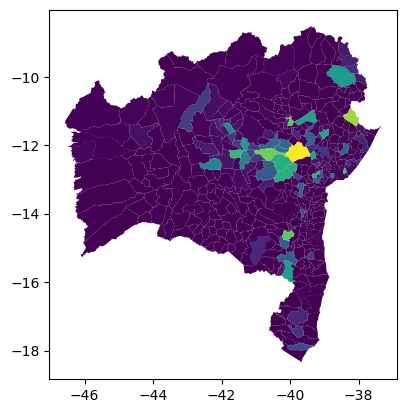

In [35]:
r.plot(column = 'QT_VOTOS_NOMINAIS_VALIDOS')

<Axes: >

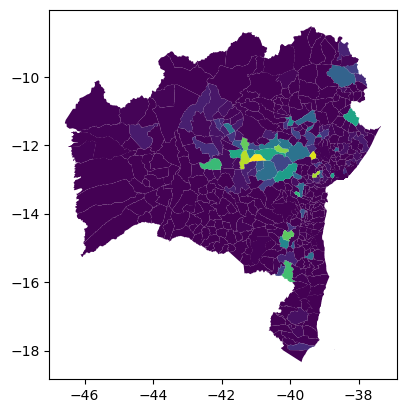

In [31]:
r.plot(column = 'Percent')

In [33]:
r.explore(column = 'Percent')

In [ ]:
querry = """
SELECT vp1.*
FROM votos_partido as vp1, votos_partido as vp2
WHERE vp1.CD_MUN = vp2.CD_MUN AND VP1.DS_CARGO = VP2.DS_CARGO AND vp1.NR_PARTIDO != vp2.NR_PARTIDO AND VP1.NR_PARTIDO = 13 AND VP1.QT_VOTOS_NOMINAIS_VALIDOS > VP2.QT_VOTOS_NOMINAIS_VALIDOS
GROUP BY vp1.CD_MUN
"""

r = pd.read_sql_query(querry,connection)
r

In [ ]:
querry = """
SELECT m.*, vp.QT_VOTOS_NOMINAIS_VALIDOS
FROM municipio as m, (SELECT vp1.*
FROM votos_partido as vp1, votos_partido as vp2
WHERE vp1.CD_MUN = vp2.CD_MUN AND VP1.DS_CARGO = VP2.DS_CARGO AND vp1.NR_PARTIDO != vp2.NR_PARTIDO AND VP1.NR_PARTIDO = 13 AND VP1.QT_VOTOS_NOMINAIS_VALIDOS > VP2.QT_VOTOS_NOMINAIS_VALIDOS
GROUP BY vp1.CD_MUN) as vp
WHERE m.cd_mun = vp.cd_mun
"""

r = geopandas.read_postgis(querry,connection, geom_col = 'GEOMETRY')
r

In [ ]:
r.plot(column = 'QT_VOTOS_NOMINAIS_VALIDOS')

In [ ]:
r.explore(column = 'QT_VOTOS_NOMINAIS_VALIDOS')

In [37]:
connection.close()